In [1]:
import pandas as pd
import os
import matplotlib.pyplot as plt
import numpy as np
from scipy.stats import linregress
import plotly.express as px
#from Spotify_tracks_artist_func import get_tracks_artist 

In [46]:
# Reading MSD dataframe
df = pd.read_pickle("msd.pkl")

In [47]:
# Adding feature to the MSD dataset, count the number of songs per artist
artist_count = df.groupby('artist_id').size().reset_index(name='artist_count')
# add new column to original dataframe with the count values
df = pd.merge(df, artist_count, on='artist_id', how='left')
df

,msd_id,artist_id,artist_name,artist_familiarity,artist_hotttnesss,song_id,song_title,song_hotttnesss,year,loudness,...,timbre_03,timbre_04,timbre_05,timbre_06,timbre_07,timbre_08,timbre_09,timbre_10,timbre_11,artist_count
0,TRAAAAK128F9318786,ARJNIUY12298900C91,Adelitas Way,0.639903,0.461318,SOBLFFE12AF72AA5BA,Scream,0.733372,2009,-4.769,...,-3.587889,-20.106800,-18.658962,-1.038959,-2.737944,15.459583,7.449359,-0.611774,6.441774,14
1,TRAAAAV128F421A322,AR73AIO1187B9AD57B,Western Addiction,0.671755,0.386606,SOQPWCR12A6D4FB2A3,A Poor Recipe For Civic Cohesion,0.481694,2005,-7.240,...,-3.838201,-36.202827,-14.462259,-8.112774,-5.117711,5.141901,6.606201,-1.225157,1.994838,15
2,TRAAAAW128F429D538,ARD7TVE1187B99BFB1,Casual,0.581794,0.401998,SOMZWCG12A8C13C480,I Didn't Mean To,0.602120,0,-11.197,...,-0.789844,-43.234903,15.170947,15.139038,1.505001,6.589571,12.298555,-13.563280,5.442480,81
3,TRAAAAY128F42A73F0,ARL752Q1187FB35EFE,Alquimia,0.476941,0.307080,SOJDASC12A8C13EB49,The Lark In The Clear Air,0.000000,0,-13.179,...,-6.001496,21.493252,-1.329707,-22.151305,-4.100979,18.763752,-3.395567,-1.670094,2.391530,39
4,TRAAABD128F429CF47,ARMJAGH1187FB546F3,The Box Tops,0.630630,0.417500,SOCIWDW12A8C13D406,Soul Deep,0.000000,1969,-9.843,...,12.923576,-2.545036,5.052395,9.238151,-4.345975,5.224104,2.935664,-2.752638,1.729396,80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,TRZZZZD128F4236844,ART48CP1187B9AE314,Rush,0.750000,0.546253,SOANRDO12A81C21E36,Mr. Soul (Album Version),0.618305,0,-4.448,...,-1.834643,-30.658570,-13.684071,-1.790805,-13.773955,14.636109,-4.396231,0.446055,-1.901775,99
999996,TRZZZZK128F4227B6F,ARW24PI1187B9A6126,Jewel,0.768696,0.509528,SOBEIVI12A6D4FC59C,This Way (Album Version),0.269382,0,-8.419,...,-7.364445,2.827664,-19.522597,3.053131,-3.420750,10.390014,3.266058,2.169933,3.968517,111
999997,TRZZZZL128F92F9D4A,ARJYJWK1187FB3ADF9,Reel People,0.515522,0.383391,SOSMBMU12AB0184258,Outta Love (reprise),0.000000,2007,-12.935,...,-11.085241,-6.127008,-12.027079,-29.067466,-7.551940,13.227598,-1.656947,0.801008,13.410248,42
999998,TRZZZZO128F428E2D4,ARBVT1L1187B99195A,Ruper Ordorika,0.490098,0.388246,SOFVEQG12A8C13F3BE,Hamabostean Behin,0.000000,0,-13.314,...,7.711604,19.642328,-0.162844,-23.031911,-8.103399,2.539860,3.922876,3.119569,3.771641,50


In [19]:
def scatter_plot(df, feature1, feature2, color_var):
    # Define x and y variables
    x = df[feature1]
    y = df[feature2]
    c = df[color_var]

    # Create scatter plot with color gradient
    plt.scatter(x, y, c=c, cmap='coolwarm')
    
    # add colorbar
    cbar = plt.colorbar()
    cbar.ax.set_ylabel(color_var)

    # add labels and title
    plt.xlabel(feature1)
    plt.ylabel(feature2)
    plt.title('Scatter Plot with Color Map')

    # Calculate the regression line
    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    # calculate correlation coefficient
    corr_coef = np.corrcoef(x, y)[0, 1]

    # add text to plot
    plt.title(f"Correlation Coefficient: {corr_coef:.2f}")

    # Add regression line
    plt.plot(x, slope*x + intercept, 'r', label='fitted line')

    # Add legend
    plt.legend()

    # show the plot
    plt.show()

C:\Users\DahianaMejia\anaconda3\envs\cse-6242-project\Lib\site-packages\IPython\core\pylabtools.py:152: UserWarning: Creating legend with loc="best" can be slow with large amounts of data.
  fig.canvas.print_figure(bytes_io, **kw)


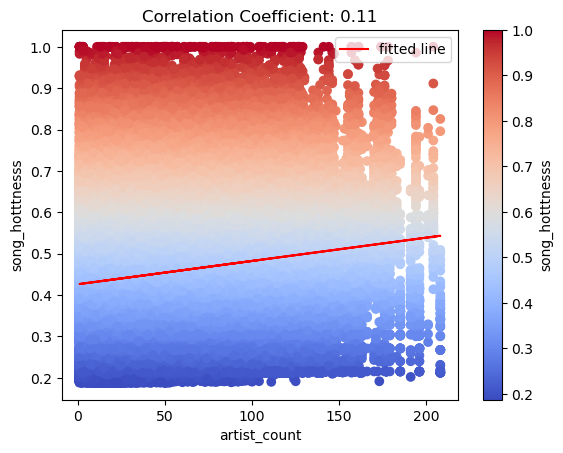

In [21]:
drop_zero_song_hot = df[df['song_hotttnesss'] > 0]    
scatter_plot(drop_zero_song_hot, 'artist_count', 'song_hotttnesss', 'song_hotttnesss')

## Making spotify dataset (DO NOT RUN THESE CELLS, SPO DATASETS ARE ALREADY CREATED)

In [ ]:
# Get ramdom artists from msd
# Set the number of names to randomly select
num_names_to_select = 25

# Randomly select names from the 'names' column
selected_names = np.random.choice(df['artist_name'], size=num_names_to_select, replace=False)

# Display the selected names DataFrame
print(selected_names)

In [ ]:
os.environ["SPOTIPY_CLIENT_ID"] = ""
os.environ["SPOTIPY_CLIENT_SECRET"] = ""

import spotipy
from spotipy.oauth2 import SpotifyClientCredentials

# This is now our connection
spotify = spotipy.Spotify(auth_manager=SpotifyClientCredentials())

In [ ]:
def get_tracks_artist(artist_input='coldplay'):
    # Get artist info
    results = spotify.search(q="artist:" + artist_input, type='artist')

    # Create df with results
    df = pd.DataFrame.from_dict(results["artists"]["items"])

    # Album info for artist
    artist_name = df.iloc[0]["name"]
    artist_uri = df.iloc[0]["uri"]
    artist = spotify.artist(artist_uri)

    df_albums = pd.DataFrame.from_dict(spotify.artist_albums(df.iloc[0]["id"]))

    # All the Tracks on Spotify for the Artist
    tracks_dict_list = []

    for i in range(len(df_albums)):
        df_album_tracks = pd.DataFrame.from_dict(spotify.album_tracks(df_albums.iloc[i]["items"]["id"]))
        for j in range(len(df_album_tracks)):
            track_dict = {
                "artist": df_albums.iloc[i]["items"]["artists"][0]["name"],
                "track": df_album_tracks.iloc[j]["items"]["name"],
                "track_id": df_album_tracks.iloc[j]["items"]["id"],
            }
            tracks_dict_list.append(track_dict)
            
    df_tracks = pd.DataFrame.from_dict(tracks_dict_list)

    # Get Track Info comparable to Metadata for MSD
    audio_features_cols = ["danceability", "energy", "key", "loudness", "tempo"]

    def get_audio_features(x):
        return pd.Series(pd.DataFrame.from_dict(spotify.audio_features(x["track_id"]))[audio_features_cols].to_numpy().flatten().tolist())
    
    df_tracks[audio_features_cols] = df_tracks.apply(lambda x: get_audio_features(x), axis=1)


    # Get track ids from df to get popularity
    tracks_ids = df_tracks['track_id'].tolist()
    # Get the track details including popularity
    track_details = [spotify.track(track_id) for track_id in tracks_ids]

    # Get popluarity
    df_pop = pd.DataFrame(track_details)
    df_pop = df_pop.rename(columns={'id': 'track_id'})
    df_pop = df_pop[['track_id','popularity']]

    # Join popularity with df_tracks
    df_with_pop = df_tracks.merge(df_pop, on='track_id', how='inner')

    return df_with_pop

In [ ]:
df_spotify = get_tracks_artist('Kamelot')
print(df_spotify.count())

In [ ]:
df_spotify1 = get_tracks_artist('Outformation')
print(df_spotify1.count())

In [ ]:
df_spotify2 = get_tracks_artist('Looptroop')
print(df_spotify2.count())

In [ ]:
df_spotify3 = get_tracks_artist('Madonna')
print(df_spotify3.count())

In [ ]:
df_spotify4 = get_tracks_artist('Barbara Lusch')
print(df_spotify4.count())

In [ ]:
df_spotify5 = get_tracks_artist('Leggo Beast')
print(df_spotify5.count())

In [ ]:
df_spotify6 = get_tracks_artist('Tania Libertad')
print(df_spotify6.count())

In [ ]:
df_spotify7 = get_tracks_artist('Margo Guryan')
print(df_spotify7.count())

In [ ]:
spotify_df_combined = pd.concat([df_spotify, df_spotify1, df_spotify2, df_spotify3, df_spotify4, df_spotify5, 
                                 df_spotify6, df_spotify7])
# Export csv for spotify dataset with several artists
spotify_df_combined.to_csv('spotify_artists.csv', index=False)

In [ ]:
df_spotify8 = get_tracks_artist('White Rabbits')
print(df_spotify8.count())

In [ ]:
df_spotify9 = get_tracks_artist('Slut')
print(df_spotify9.count())

In [ ]:
df_spotify10 = get_tracks_artist('Choclair')
print(df_spotify10.count())

In [ ]:
spotify_df_combined = pd.concat([df_spotify, df_spotify1, df_spotify2, df_spotify3, df_spotify4, df_spotify5, 
                                 df_spotify6, df_spotify7, df_spotify8, df_spotify9, df_spotify10])
# Export csv for spotify dataset with several artists
spotify_df_combined.to_csv('spotify_artists.csv', index=False)

In [ ]:
df_spotify11 = get_tracks_artist('Cortney Tidwell')
print(df_spotify11.count())

In [ ]:
df_spotify12 = get_tracks_artist('Lelio Luttazzi')
print(df_spotify12.count())

In [ ]:
df_spotify13 = get_tracks_artist('Jose Alberto')
print(df_spotify13.count())

In [ ]:
spotify_df_combined = pd.concat([df_spotify, df_spotify1, df_spotify2, df_spotify3, df_spotify4, df_spotify5, 
                                 df_spotify6, df_spotify7, df_spotify8, df_spotify9, df_spotify10, df_spotify11,
                                df_spotify12, df_spotify13])
# Export csv for spotify dataset with several artists
spotify_df_combined.to_csv('spotify_artists.csv', index=False)

In [ ]:
df_spotify14 = get_tracks_artist('Liquido')
print(df_spotify14.count())

In [ ]:
df_spotify15 = get_tracks_artist('Celine Dion')
print(df_spotify15.count())

In [ ]:
spotify_df_combined = pd.concat([df_spotify, df_spotify1, df_spotify2, df_spotify3, df_spotify4, df_spotify5, 
                                 df_spotify6, df_spotify7, df_spotify8, df_spotify9, df_spotify10, df_spotify11,
                                df_spotify12, df_spotify13, df_spotify14, df_spotify15])
# Export csv for spotify dataset with several artists
spotify_df_combined.to_csv('spotify_artists.csv', index=False)

In [ ]:
df_spotify16 = get_tracks_artist('Mariah Carey')
print(df_spotify16.count())

In [ ]:
df_spotify17 = get_tracks_artist('Benjamin Biolay')
print(df_spotify17.count())

In [ ]:
spotify_df_combined = pd.concat([df_spotify, df_spotify1, df_spotify2, df_spotify3, df_spotify4, df_spotify5, 
                                 df_spotify6, df_spotify7, df_spotify8, df_spotify9, df_spotify10, df_spotify11,
                                df_spotify12, df_spotify13, df_spotify14, df_spotify15, df_spotify16, df_spotify17])
# Export csv for spotify dataset with several artists
spotify_df_combined.to_csv('spotify_artists.csv', index=False)

In [ ]:
df_spotify18 = get_tracks_artist('Celia Cruz')
print(df_spotify18.count())

In [ ]:
df_spotify19 = get_tracks_artist('Paul McCartney')
print(df_spotify19.count())

In [ ]:
df_spotify20 = get_tracks_artist('Soda Stereo')
print(df_spotify20.count())

## Combining all Spotify dataframes

In [ ]:
# Append spotify dataframes
spotify_df = pd.concat([df_spotify, df_spotify1, df_spotify2, df_spotify3, df_spotify4, df_spotify5, 
                                 df_spotify6, df_spotify7, df_spotify8, df_spotify9, df_spotify10, df_spotify11,
                                df_spotify12, df_spotify13, df_spotify14, df_spotify15, df_spotify16, df_spotify17,
                                df_spotify18, df_spotify19, df_spotify20])
print(spotify_df.count())                            

In [ ]:
# Export csv for spotify dataset with several artists
spotify_df.to_csv('spotify_artists.csv', index=False)

## Creating on dataframe with Spotify datasets

In [49]:
# Concat both spotify datasets
df_dataset1 = pd.read_csv('spotify_artists_dataset1.csv')
df_dataset2 = pd.read_csv('spotify_artists_dataset2.csv')
spotify_df_combined = pd.concat([df_dataset1, df_dataset2], ignore_index=True)

In [50]:
spotify_df_combined.count()

artist          10686
track           10686
track_id        10686
danceability    10686
energy          10686
key             10686
loudness        10686
tempo           10686
popularity      10686
dtype: int64

In [51]:
print(df.columns)
print(spotify_df_combined.columns)

Index(['msd_id', 'artist_id', 'artist_name', 'artist_familiarity',
       'artist_hotttnesss', 'song_id', 'song_title', 'song_hotttnesss', 'year',
       'loudness', 'energy', 'danceability', 'tempo',
       'pitch_network_average_degree', 'pitch_network_entropy',
       'pitch_network_mean_clustering_coeff', 'timbre_00', 'timbre_01',
       'timbre_02', 'timbre_03', 'timbre_04', 'timbre_05', 'timbre_06',
       'timbre_07', 'timbre_08', 'timbre_09', 'timbre_10', 'timbre_11',
       'artist_count'],
      dtype='object')
Index(['artist', 'track', 'track_id', 'danceability', 'energy', 'key',
       'loudness', 'tempo', 'popularity'],
      dtype='object')


In [52]:
# Drop columns with 0's in MSD danceability and energy 
df_MSD = df.drop(columns=['energy', 'danceability'])

# convert the string values to lowercase
df_MSD['song_title'] = df_MSD['song_title'].str.lower()
spotify_df_combined['track'] = spotify_df_combined['track'].str.lower()
df_MSD['artist_name'] = df_MSD['artist_name'].str.lower()
spotify_df_combined['artist'] = spotify_df_combined['artist'].str.lower()

# Add suffix to CSD and spotify df
df_MSD = df_MSD.add_suffix('_MSD')
spotify_df_combined = spotify_df_combined.add_suffix('_Spo')

In [53]:
# Inner Join spotify dataframe with MSD by song title and artist name
# perform the inner join on song_id and tracks
merged_df = pd.merge(df_MSD, spotify_df_combined, how='inner', left_on=['song_title_MSD', 'artist_name_MSD'], 
                     right_on=['track_Spo', 'artist_Spo'])
print(merged_df.count())

msd_id_MSD                                 1391
artist_id_MSD                              1391
artist_name_MSD                            1391
artist_familiarity_MSD                     1391
artist_hotttnesss_MSD                      1391
song_id_MSD                                1391
song_title_MSD                             1391
song_hotttnesss_MSD                        1391
year_MSD                                   1391
loudness_MSD                               1391
tempo_MSD                                  1391
pitch_network_average_degree_MSD           1391
pitch_network_entropy_MSD                  1391
pitch_network_mean_clustering_coeff_MSD    1391
timbre_00_MSD                              1391
timbre_01_MSD                              1391
timbre_02_MSD                              1391
timbre_03_MSD                              1391
timbre_04_MSD                              1391
timbre_05_MSD                              1391
timbre_06_MSD                           

In [27]:
# Create new variable popularity for MSD data merged_df to compare with popularity from Spotify
merged_df['popularity_MSD'] = merged_df['song_hotttnesss_MSD'] * merged_df['artist_count_MSD']

In [28]:
# Get numerical df
df_numerical = merged_df[['artist_familiarity_MSD', 'artist_hotttnesss_MSD', 'song_hotttnesss_MSD', 
                          'loudness_MSD', 'tempo_MSD', 'artist_count_MSD', 'popularity_MSD','danceability_Spo', 'energy_Spo', 
                          'key_Spo', 'loudness_Spo', 'tempo_Spo', 'popularity_Spo']]

In [29]:
df_pitches = merged_df[['pitch_network_average_degree_MSD', 'pitch_network_entropy_MSD', 
                        'pitch_network_mean_clustering_coeff_MSD','popularity_Spo']]

In [30]:
df_timbre = merged_df[['timbre_00_MSD', 'timbre_01_MSD', 'timbre_02_MSD', 'timbre_03_MSD',
       'timbre_04_MSD', 'timbre_05_MSD', 'timbre_06_MSD', 'timbre_07_MSD',
       'timbre_08_MSD', 'timbre_09_MSD', 'timbre_10_MSD', 'timbre_11_MSD','popularity_Spo']]

## Plots for merged_df(df with matching data from MSD and Spotify)

In [31]:
# Plots df_numerical
feature_list = ['artist_familiarity_MSD', 'artist_hotttnesss_MSD', 'song_hotttnesss_MSD', 
                          'loudness_MSD', 'tempo_MSD', 'popularity_MSD', 'danceability_Spo', 'energy_Spo', 
                          'loudness_Spo', 'tempo_Spo', 'artist_count_MSD', 'popularity_Spo']
color_feature = 'popularity_Spo'
fig = px.scatter_matrix(df_numerical, dimensions=feature_list, color=color_feature, labels={col: col.replace('_', ' ').title() for col in feature_list},
                        height=1800, width=1800)
fig.show()

In [32]:
# Plots df_pitches
feature_list = ['pitch_network_average_degree_MSD', 'pitch_network_entropy_MSD', 
                        'pitch_network_mean_clustering_coeff_MSD','popularity_Spo']
color_feature = 'popularity_Spo'
fig = px.scatter_matrix(df_pitches, dimensions=feature_list, color=color_feature, labels={col: col.replace('_', ' ').title() for col in feature_list},
                        height=700, width=700)
fig.show()

In [33]:
# Plots df_timbres
feature_list = ['timbre_00_MSD', 'timbre_01_MSD', 'timbre_02_MSD', 'timbre_03_MSD',
       'timbre_04_MSD', 'timbre_05_MSD', 'timbre_06_MSD', 'timbre_07_MSD',
       'timbre_08_MSD', 'timbre_09_MSD', 'timbre_10_MSD', 'timbre_11_MSD','popularity_Spo']
color_feature = 'popularity_Spo'
fig = px.scatter_matrix(df_timbre, dimensions=feature_list, color=color_feature, labels={col: col.replace('_', ' ').title() for col in feature_list},
                        height=1500, width=1500)
fig.show()

In [34]:
def scatter_plot(df, feature1, feature2, color_var):
    # Define x and y variables
    x = df[feature1]
    y = df[feature2]
    c = df[color_var]

    # Create scatter plot with color gradient
    plt.scatter(x, y, c=c, cmap='coolwarm')
    
    # add colorbar
    cbar = plt.colorbar()
    cbar.ax.set_ylabel(color_var)

    # add labels and title
    plt.xlabel(feature1)
    plt.ylabel(feature2)
    plt.title('Scatter Plot with Color Map')

    # Calculate the regression line
    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    # calculate correlation coefficient
    corr_coef = np.corrcoef(x, y)[0, 1]

    # add text to plot
    plt.title(f"Correlation Coefficient: {corr_coef:.2f}")

    # Add regression line
    plt.plot(x, slope*x + intercept, 'r', label='fitted line')

    # Add legend
    plt.legend()

    # show the plot
    plt.show()

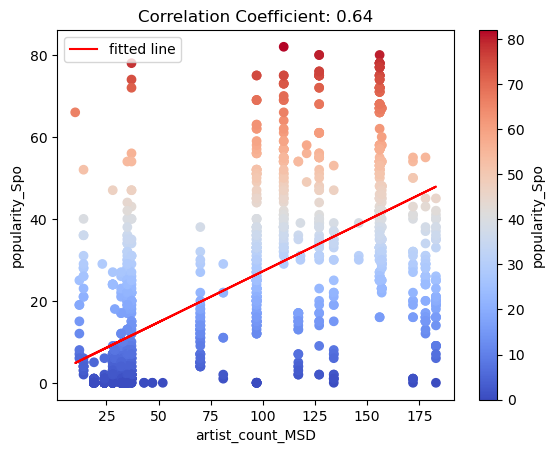

In [35]:
scatter_plot(df_numerical, 'artist_count_MSD', 'popularity_Spo', 'popularity_Spo')

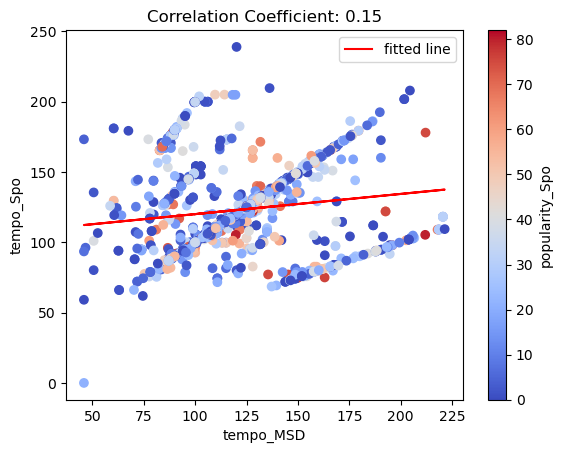

In [36]:
scatter_plot(df_numerical, 'tempo_MSD', 'tempo_Spo', 'popularity_Spo')

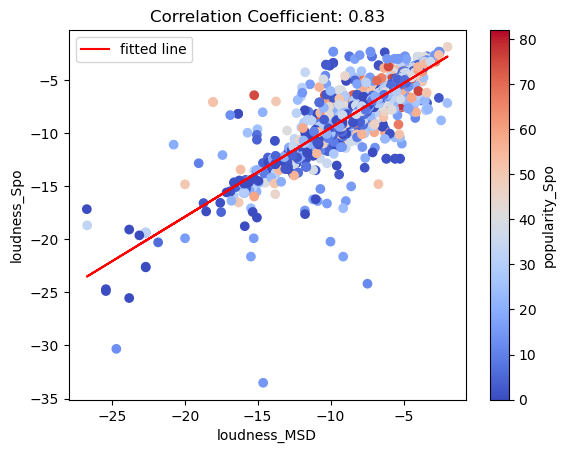

In [37]:
scatter_plot(df_numerical, 'loudness_MSD', 'loudness_Spo', 'popularity_Spo')

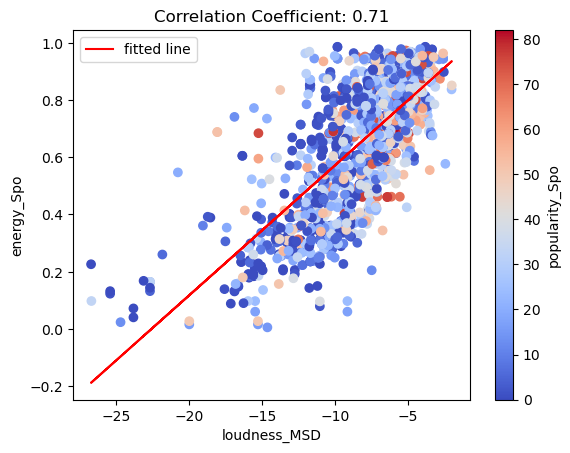

In [38]:
scatter_plot(df_numerical, 'loudness_MSD', 'energy_Spo', 'popularity_Spo')

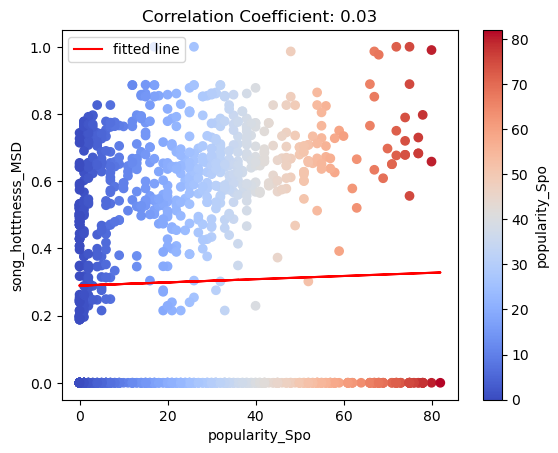

In [39]:
# Plotting 'popularity_Spo' and 'song_hotttnesss_MSD' including 0's for 'song_hotttnesss_MSD'
scatter_plot(df_numerical, 'popularity_Spo', 'song_hotttnesss_MSD', 'popularity_Spo')

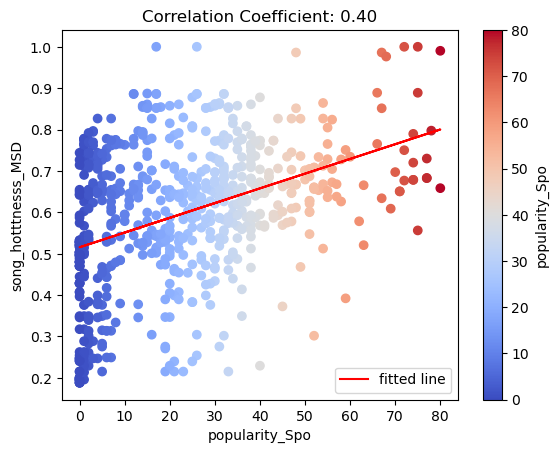

In [40]:
# Drop 0's from song hotttnesss_MSD
dfsong = df_numerical[(df_numerical['song_hotttnesss_MSD'] > 0)]
scatter_plot(dfsong, 'popularity_Spo', 'song_hotttnesss_MSD', 'popularity_Spo')

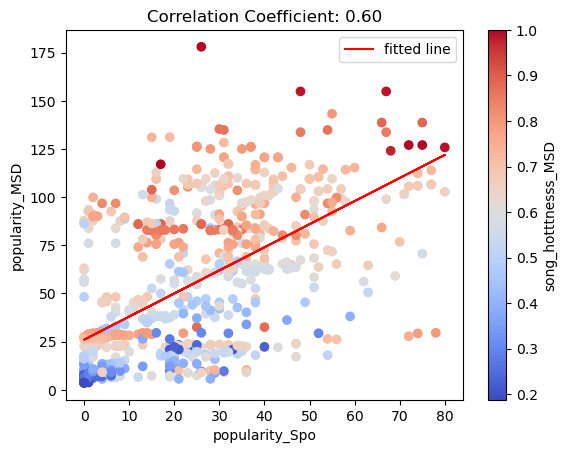

In [41]:
# Plot both popularities, 'popularity_Spo' vs 'popularity_MSD'
# 'popularity_MSD is computed from the count of the songs per artist times by "song_hotttness"
scatter_plot(dfsong, 'popularity_Spo', 'popularity_MSD', 'song_hotttnesss_MSD')

In [42]:
# Scaling popularity_MSD to a scale from 0 to 100
# Calculate the minimum and maximum values of column popularity_MSD
min_val = dfsong['popularity_MSD'].min()
max_val = dfsong['popularity_MSD'].max()

# Scale the values from 0 to 100
dfsong['popularity_MSD_scaled'] = (dfsong['popularity_MSD'] - min_val) * 100 / (max_val - min_val)

C:\Users\DahianaMejia\AppData\Local\Temp\ipykernel_10204\3835829301.py:7: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



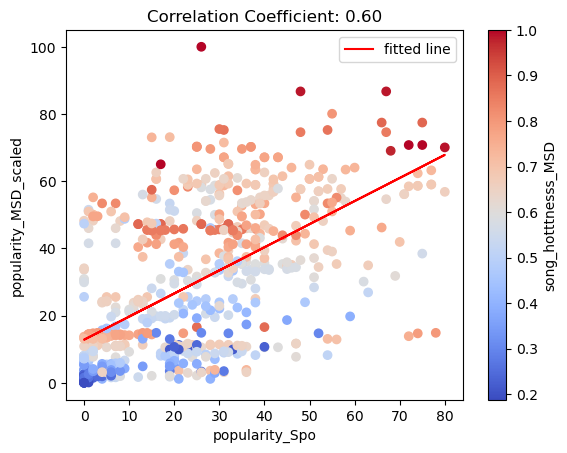

In [43]:
scatter_plot(dfsong, 'popularity_Spo', 'popularity_MSD_scaled', 'song_hotttnesss_MSD')

## Create the new pkl dataset for PCA model

In [54]:
# Original pkl dataframe with song count per artist
df

,msd_id,artist_id,artist_name,artist_familiarity,artist_hotttnesss,song_id,song_title,song_hotttnesss,year,loudness,...,timbre_03,timbre_04,timbre_05,timbre_06,timbre_07,timbre_08,timbre_09,timbre_10,timbre_11,artist_count
0,TRAAAAK128F9318786,ARJNIUY12298900C91,Adelitas Way,0.639903,0.461318,SOBLFFE12AF72AA5BA,Scream,0.733372,2009,-4.769,...,-3.587889,-20.106800,-18.658962,-1.038959,-2.737944,15.459583,7.449359,-0.611774,6.441774,14
1,TRAAAAV128F421A322,AR73AIO1187B9AD57B,Western Addiction,0.671755,0.386606,SOQPWCR12A6D4FB2A3,A Poor Recipe For Civic Cohesion,0.481694,2005,-7.240,...,-3.838201,-36.202827,-14.462259,-8.112774,-5.117711,5.141901,6.606201,-1.225157,1.994838,15
2,TRAAAAW128F429D538,ARD7TVE1187B99BFB1,Casual,0.581794,0.401998,SOMZWCG12A8C13C480,I Didn't Mean To,0.602120,0,-11.197,...,-0.789844,-43.234903,15.170947,15.139038,1.505001,6.589571,12.298555,-13.563280,5.442480,81
3,TRAAAAY128F42A73F0,ARL752Q1187FB35EFE,Alquimia,0.476941,0.307080,SOJDASC12A8C13EB49,The Lark In The Clear Air,0.000000,0,-13.179,...,-6.001496,21.493252,-1.329707,-22.151305,-4.100979,18.763752,-3.395567,-1.670094,2.391530,39
4,TRAAABD128F429CF47,ARMJAGH1187FB546F3,The Box Tops,0.630630,0.417500,SOCIWDW12A8C13D406,Soul Deep,0.000000,1969,-9.843,...,12.923576,-2.545036,5.052395,9.238151,-4.345975,5.224104,2.935664,-2.752638,1.729396,80
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,TRZZZZD128F4236844,ART48CP1187B9AE314,Rush,0.750000,0.546253,SOANRDO12A81C21E36,Mr. Soul (Album Version),0.618305,0,-4.448,...,-1.834643,-30.658570,-13.684071,-1.790805,-13.773955,14.636109,-4.396231,0.446055,-1.901775,99
999996,TRZZZZK128F4227B6F,ARW24PI1187B9A6126,Jewel,0.768696,0.509528,SOBEIVI12A6D4FC59C,This Way (Album Version),0.269382,0,-8.419,...,-7.364445,2.827664,-19.522597,3.053131,-3.420750,10.390014,3.266058,2.169933,3.968517,111
999997,TRZZZZL128F92F9D4A,ARJYJWK1187FB3ADF9,Reel People,0.515522,0.383391,SOSMBMU12AB0184258,Outta Love (reprise),0.000000,2007,-12.935,...,-11.085241,-6.127008,-12.027079,-29.067466,-7.551940,13.227598,-1.656947,0.801008,13.410248,42
999998,TRZZZZO128F428E2D4,ARBVT1L1187B99195A,Ruper Ordorika,0.490098,0.388246,SOFVEQG12A8C13F3BE,Hamabostean Behin,0.000000,0,-13.314,...,7.711604,19.642328,-0.162844,-23.031911,-8.103399,2.539860,3.922876,3.119569,3.771641,50


In [55]:
# Compute popularity for MSD data and scale popularity from 0 to 100
df['popularity'] = df['song_hotttnesss'] * df['artist_count'].copy()
# Calculate the minimum and maximum values of column popularity_MSD
min_val = df['popularity'].min()
max_val = df['popularity'].max()

# Scale the values from 0 to 100
df['popularity_scaled'] = (df['popularity'] - min_val) * 100 / (max_val - min_val)
df

,msd_id,artist_id,artist_name,artist_familiarity,artist_hotttnesss,song_id,song_title,song_hotttnesss,year,loudness,...,timbre_05,timbre_06,timbre_07,timbre_08,timbre_09,timbre_10,timbre_11,artist_count,popularity,popularity_scaled
0,TRAAAAK128F9318786,ARJNIUY12298900C91,Adelitas Way,0.639903,0.461318,SOBLFFE12AF72AA5BA,Scream,0.733372,2009,-4.769,...,-18.658962,-1.038959,-2.737944,15.459583,7.449359,-0.611774,6.441774,14,10.267203,5.032942
1,TRAAAAV128F421A322,AR73AIO1187B9AD57B,Western Addiction,0.671755,0.386606,SOQPWCR12A6D4FB2A3,A Poor Recipe For Civic Cohesion,0.481694,2005,-7.240,...,-14.462259,-8.112774,-5.117711,5.141901,6.606201,-1.225157,1.994838,15,7.225412,3.541869
2,TRAAAAW128F429D538,ARD7TVE1187B99BFB1,Casual,0.581794,0.401998,SOMZWCG12A8C13C480,I Didn't Mean To,0.602120,0,-11.197,...,15.170947,15.139038,1.505001,6.589571,12.298555,-13.563280,5.442480,81,48.771719,23.907705
3,TRAAAAY128F42A73F0,ARL752Q1187FB35EFE,Alquimia,0.476941,0.307080,SOJDASC12A8C13EB49,The Lark In The Clear Air,0.000000,0,-13.179,...,-1.329707,-22.151305,-4.100979,18.763752,-3.395567,-1.670094,2.391530,39,0.000000,0.000000
4,TRAAABD128F429CF47,ARMJAGH1187FB546F3,The Box Tops,0.630630,0.417500,SOCIWDW12A8C13D406,Soul Deep,0.000000,1969,-9.843,...,5.052395,9.238151,-4.345975,5.224104,2.935664,-2.752638,1.729396,80,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,TRZZZZD128F4236844,ART48CP1187B9AE314,Rush,0.750000,0.546253,SOANRDO12A81C21E36,Mr. Soul (Album Version),0.618305,0,-4.448,...,-13.684071,-1.790805,-13.773955,14.636109,-4.396231,0.446055,-1.901775,99,61.212157,30.005959
999996,TRZZZZK128F4227B6F,ARW24PI1187B9A6126,Jewel,0.768696,0.509528,SOBEIVI12A6D4FC59C,This Way (Album Version),0.269382,0,-8.419,...,-19.522597,3.053131,-3.420750,10.390014,3.266058,2.169933,3.968517,111,29.901432,14.657565
999997,TRZZZZL128F92F9D4A,ARJYJWK1187FB3ADF9,Reel People,0.515522,0.383391,SOSMBMU12AB0184258,Outta Love (reprise),0.000000,2007,-12.935,...,-12.027079,-29.067466,-7.551940,13.227598,-1.656947,0.801008,13.410248,42,0.000000,0.000000
999998,TRZZZZO128F428E2D4,ARBVT1L1187B99195A,Ruper Ordorika,0.490098,0.388246,SOFVEQG12A8C13F3BE,Hamabostean Behin,0.000000,0,-13.314,...,-0.162844,-23.031911,-8.103399,2.539860,3.922876,3.119569,3.771641,50,0.000000,0.000000


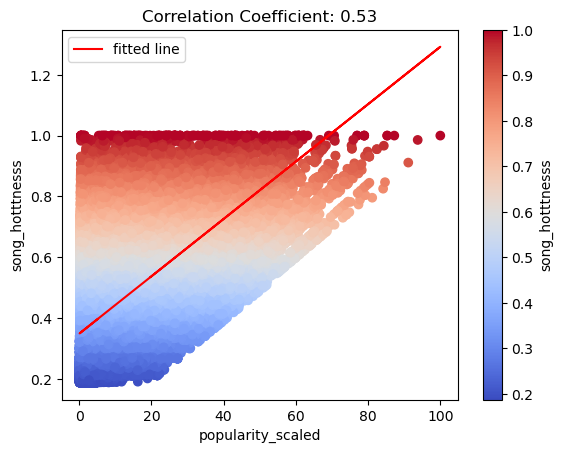

In [56]:
#df_final = df[(df['song_hotttnesss'] > 0)]
df_final = df
scatter_plot(df_final[df_final['popularity_scaled']>0], 'popularity_scaled', 'song_hotttnesss', 'song_hotttnesss')

In [57]:
# rename popularity_scaled and drop popularity to export pkl
df_final = df_final.drop("popularity", axis=1)
df_final = df_final.rename(columns={'popularity_scaled' : 'popularity'})
df_final

,msd_id,artist_id,artist_name,artist_familiarity,artist_hotttnesss,song_id,song_title,song_hotttnesss,year,loudness,...,timbre_04,timbre_05,timbre_06,timbre_07,timbre_08,timbre_09,timbre_10,timbre_11,artist_count,popularity
0,TRAAAAK128F9318786,ARJNIUY12298900C91,Adelitas Way,0.639903,0.461318,SOBLFFE12AF72AA5BA,Scream,0.733372,2009,-4.769,...,-20.106800,-18.658962,-1.038959,-2.737944,15.459583,7.449359,-0.611774,6.441774,14,5.032942
1,TRAAAAV128F421A322,AR73AIO1187B9AD57B,Western Addiction,0.671755,0.386606,SOQPWCR12A6D4FB2A3,A Poor Recipe For Civic Cohesion,0.481694,2005,-7.240,...,-36.202827,-14.462259,-8.112774,-5.117711,5.141901,6.606201,-1.225157,1.994838,15,3.541869
2,TRAAAAW128F429D538,ARD7TVE1187B99BFB1,Casual,0.581794,0.401998,SOMZWCG12A8C13C480,I Didn't Mean To,0.602120,0,-11.197,...,-43.234903,15.170947,15.139038,1.505001,6.589571,12.298555,-13.563280,5.442480,81,23.907705
3,TRAAAAY128F42A73F0,ARL752Q1187FB35EFE,Alquimia,0.476941,0.307080,SOJDASC12A8C13EB49,The Lark In The Clear Air,0.000000,0,-13.179,...,21.493252,-1.329707,-22.151305,-4.100979,18.763752,-3.395567,-1.670094,2.391530,39,0.000000
4,TRAAABD128F429CF47,ARMJAGH1187FB546F3,The Box Tops,0.630630,0.417500,SOCIWDW12A8C13D406,Soul Deep,0.000000,1969,-9.843,...,-2.545036,5.052395,9.238151,-4.345975,5.224104,2.935664,-2.752638,1.729396,80,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
999995,TRZZZZD128F4236844,ART48CP1187B9AE314,Rush,0.750000,0.546253,SOANRDO12A81C21E36,Mr. Soul (Album Version),0.618305,0,-4.448,...,-30.658570,-13.684071,-1.790805,-13.773955,14.636109,-4.396231,0.446055,-1.901775,99,30.005959
999996,TRZZZZK128F4227B6F,ARW24PI1187B9A6126,Jewel,0.768696,0.509528,SOBEIVI12A6D4FC59C,This Way (Album Version),0.269382,0,-8.419,...,2.827664,-19.522597,3.053131,-3.420750,10.390014,3.266058,2.169933,3.968517,111,14.657565
999997,TRZZZZL128F92F9D4A,ARJYJWK1187FB3ADF9,Reel People,0.515522,0.383391,SOSMBMU12AB0184258,Outta Love (reprise),0.000000,2007,-12.935,...,-6.127008,-12.027079,-29.067466,-7.551940,13.227598,-1.656947,0.801008,13.410248,42,0.000000
999998,TRZZZZO128F428E2D4,ARBVT1L1187B99195A,Ruper Ordorika,0.490098,0.388246,SOFVEQG12A8C13F3BE,Hamabostean Behin,0.000000,0,-13.314,...,19.642328,-0.162844,-23.031911,-8.103399,2.539860,3.922876,3.119569,3.771641,50,0.000000


In [ ]:
# Save the DataFrame to a .pkl file
df_final.to_pickle('msd_popularity.pkl')

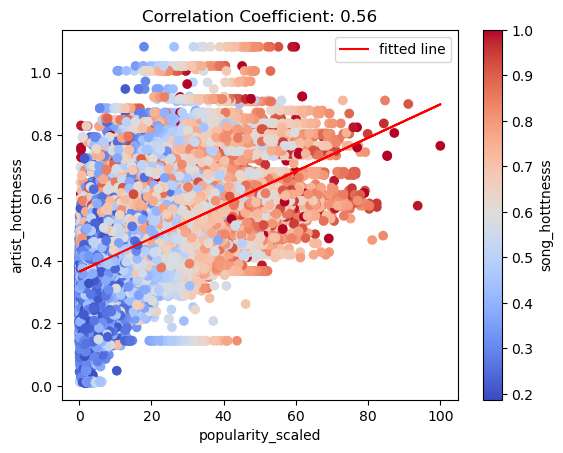

In [58]:
df_test = df[(df['artist_hotttnesss'] > 0) & (df['popularity'] > 0)]
scatter_plot(df_test, 'popularity_scaled', 'artist_hotttnesss', 'song_hotttnesss')

In [59]:
fig = px.histogram(df[df['popularity']>0], x='popularity', nbins=100, height=700, width=700)
fig.show()

In [60]:
df[df['popularity']>0].count()

msd_id                                 457205
artist_id                              457205
artist_name                            457205
artist_familiarity                     457194
artist_hotttnesss                      457205
song_id                                457205
song_title                             457205
song_hotttnesss                        457205
year                                   457205
loudness                               457205
energy                                 457205
danceability                           457205
tempo                                  457205
pitch_network_average_degree           457205
pitch_network_entropy                  457205
pitch_network_mean_clustering_coeff    457205
timbre_00                              457205
timbre_01                              457205
timbre_02                              457205
timbre_03                              457205
timbre_04                              457205
timbre_05                         